# California Housing in the 90s

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping, LambdaCallback

//anaconda3/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [4]:
from google.colab import drive
drive.mount('/content/drive/')
#!ls "/content/drive/My Drive/"

data = pd.read_csv('/content/drive/My Drive/housing.csv')
data.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


In [3]:
data.shape

(20640, 10)

Let us visualize our data points on a map showing the price once you click on it (like Zillow!), since we have the latitude and longitude coordinates.

In [5]:
import folium

m = folium.Map(location=[np.average(data['latitude']), np.average(data['longitude'])],
              tiles='Stamen Terrain', zoom_start=6)

In [6]:
for _, row in data.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=5,
        popup=row['median_house_value'],
        color='#1787FE',
        fill=True,
        fill_colour='#1787FE'
    ).add_to(m)

In [7]:
m

In [10]:
data.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


In [11]:
data.dtypes

longitude             float64
latitude              float64
housing_median_age    float64
total_rooms           float64
total_bedrooms        float64
population            float64
households            float64
median_income         float64
median_house_value    float64
ocean_proximity        object
dtype: object

In [12]:
pd.DataFrame({'# of missing values': data.isnull().sum(), '% of missing values (in %)': data.isnull().sum()/len(data)*100})

,# of missing values,% of missing values (in %)
longitude,0,0.000000
latitude,0,0.000000
housing_median_age,0,0.000000
total_rooms,0,0.000000
total_bedrooms,207,1.002907
population,0,0.000000
households,0,0.000000
median_income,0,0.000000
median_house_value,0,0.000000
ocean_proximity,0,0.000000


In [13]:
# let us make the 'total' columns into 'mean' columns
data['mean_rooms'] = data['total_rooms']/data['households']
data['mean_bedrooms'] = data['total_bedrooms']/data['households']
data.drop(['total_rooms', 'total_bedrooms'], axis=1, inplace=True)

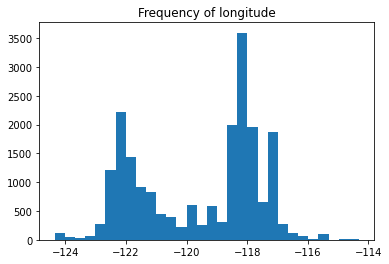

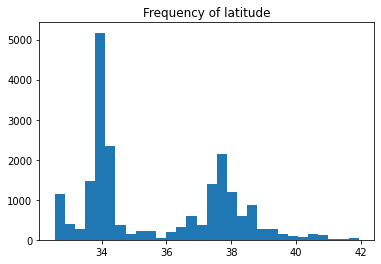

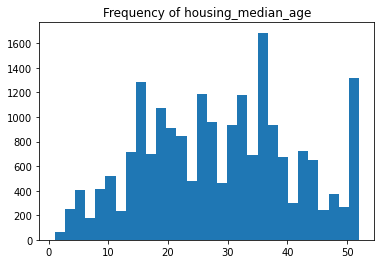

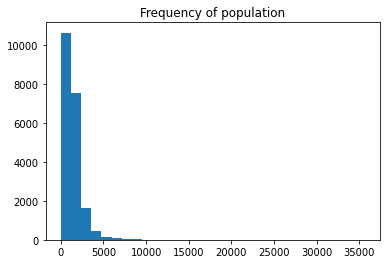

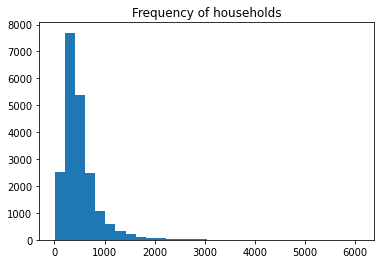

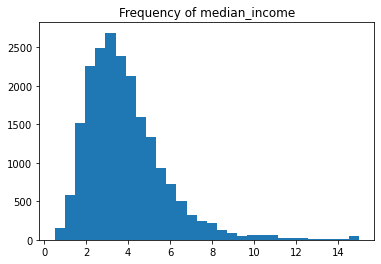

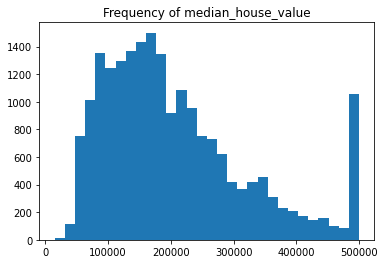

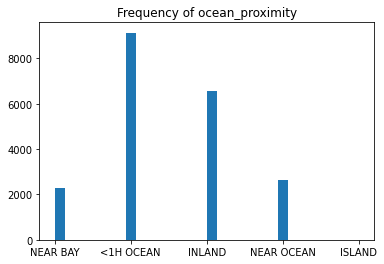

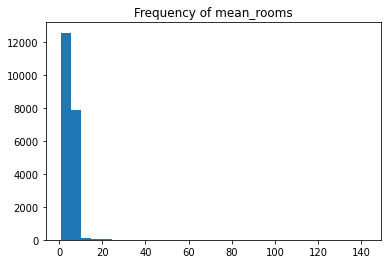

/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


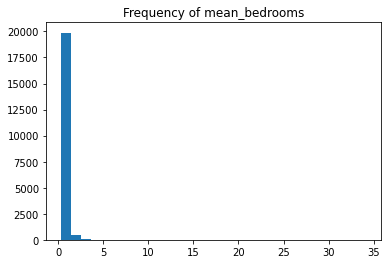

In [14]:
for column in list(data.columns):
    plt.hist(data[column], bins=30)
    plt.title(f'Frequency of {column}')
    plt.show()

A couple things to note from the histograms above:

* It looks like both median_house_value and housing_median_age have been capped (since there were certainly people aged > 50 living in California in the 90s and houses in California, even in the 90s, were certainly valued at > $500,000). We need to figure out how to deal with these capped values.
* We need to standardize numerical variables (let us not standardize the dependent variable to avoid hassle).

In [15]:
# deal with categorical variables and scale numerical variables
from sklearn.preprocessing import StandardScaler, RobustScaler

data['ocean_proximity'] = data['ocean_proximity'].astype('category')
data['ocean_proximity'] = data['ocean_proximity'].cat.codes.astype('float64')

scaler = RobustScaler()
scaled_array = scaler.fit_transform(data)
data = pd.DataFrame(scaled_array, 
                    columns=data.columns.values)

In [16]:
data.head()

,longitude,latitude,housing_median_age,population,households,median_income,median_house_value,ocean_proximity,mean_rooms,mean_bedrooms
0,-0.986807,0.957672,0.631579,-0.899787,-0.870769,2.197582,1.880448,2.0,1.088935,-0.267935
1,-0.984169,0.952381,-0.421053,1.316631,2.243077,2.186664,1.232041,2.0,0.626066,-0.822719
2,-0.989446,0.949735,1.210526,-0.714286,-0.713846,1.707732,1.187941,2.0,1.898042,0.262359
3,-0.992084,0.949735,1.210526,-0.648188,-0.584615,0.967177,1.113523,2.0,0.364978,0.258225
4,-0.992084,0.949735,1.210526,-0.640725,-0.461538,0.142854,1.119724,2.0,0.653191,0.343925


To deal with the missing values let us remove for now. Then, during validation, let us impute with the median and see if that gives us a better fit. We can observe that the missing values are indeed missing at random.

In [17]:
# option a: remove
data = data.drop(data[data['mean_bedrooms'].isnull()].index).reset_index(drop=True)

# option b: impute
# data = data.copy()
# data['total_bedrooms'].fillna(data_b['total_bedrooms'].mean(), inplace=True)

data.head()

,longitude,latitude,housing_median_age,population,households,median_income,median_house_value,ocean_proximity,mean_rooms,mean_bedrooms
0,-0.986807,0.957672,0.631579,-0.899787,-0.870769,2.197582,1.880448,2.0,1.088935,-0.267935
1,-0.984169,0.952381,-0.421053,1.316631,2.243077,2.186664,1.232041,2.0,0.626066,-0.822719
2,-0.989446,0.949735,1.210526,-0.714286,-0.713846,1.707732,1.187941,2.0,1.898042,0.262359
3,-0.992084,0.949735,1.210526,-0.648188,-0.584615,0.967177,1.113523,2.0,0.364978,0.258225
4,-0.992084,0.949735,1.210526,-0.640725,-0.461538,0.142854,1.119724,2.0,0.653191,0.343925


In [18]:
X_train, X_test, y_train, y_test = train_test_split(data.drop('median_house_value', axis=1),
                                                   data['median_house_value'],
                                                    test_size=0.20,
                                                   random_state=0)

In [19]:
def build_model(layers=[100, 50], 
                act='relu', 
                opt='adam',
               dropout=0.1):
    
    model = Sequential()
    
    # create first hidden layer
    model.add(Dense(layers[0], input_dim=X_train.shape[1], activation=act))
    
    # create additional hidden layers
    for layer in layers[1:]:
        model.add(Dense(layer, activation=act))
        
    # add dropout
    model.add(Dropout(dropout))
    
    # create output layer
    model.add(Dense(1, activation=act))
        
    # configuration 
    model.compile(optimizer=opt, loss='mse', metrics = ['mse'])
    
    return model
    

In [20]:
from sklearn.model_selection import GridSearchCV
from keras.wrappers.scikit_learn import KerasRegressor

Using TensorFlow backend.


In [ ]:
model = KerasRegressor(build_fn=build_model, verbose=0)

# define the grid search params
batch_size = [32, 64]
epochs = [100, 200, 300]
act = ['relu', 'sigmoid']
dropout = [0.0, 0.2]
param_grid = dict(batch_size=batch_size,
               epochs=epochs,
               act=act,
               dropout=dropout)

grid = GridSearchCV(estimator=model,
                   param_grid=param_grid,
                   cv=3,
                   n_jobs=-1)

grid_result = grid.fit(X_train, y_train)

In [ ]:
grid_result.best_params_

In [21]:
nEpochs = 30
batch_size = 32

model = build_model()
early_stop = keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
training = model.fit(X_train, y_train, 
                    epochs=nEpochs, validation_split=0.2, verbose=0, batch_size=batch_size, 
                    callbacks=[early_stop])

In [22]:
training.history.keys()

dict_keys(['loss', 'mse', 'val_loss', 'val_mse'])

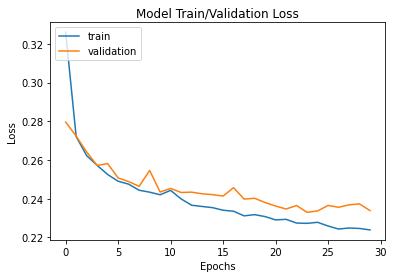

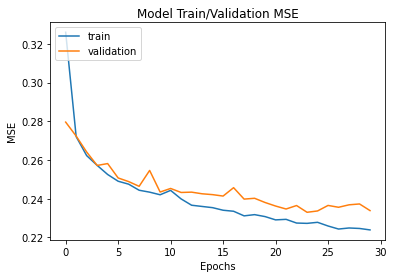

In [23]:
# plot training and validation loss
plt.plot(training.history['loss'])
plt.plot(training.history['val_loss'])
plt.title('Model Train/Validation Loss')
plt.ylabel('Loss')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# plot training and validation MSE
plt.plot(training.history['mse'])
plt.plot(training.history['val_mse'])
plt.title('Model Train/Validation MSE')
plt.ylabel('MSE')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [24]:
loss, mse = model.evaluate(X_test, y_test, verbose=0)

print("Testing set Mean Sqr Error: {:5.2f}".format(mse))

Testing set Mean Sqr Error:  0.23


Text(0, 0.5, 'Count')

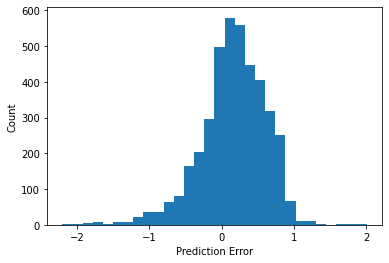

In [25]:
# Let's take a look at the error distribution
y_pred = model.predict(X_test).flatten()
error = y_pred - y_test
plt.hist(error, bins = 30)
plt.xlabel("Prediction Error")
plt.ylabel("Count")